In [1]:

# Load necessary libraries

# Preprocessing and data handling
# Import necessary libraries for data preprocessing and handling
import numpy as np
import pandas as pd
import os
import pickle
import time
import string
from collections import Counter
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split

# Visualization
# Import library for visualization using matplotlib
import matplotlib.pyplot as plt

# Suppress warnings
# Import warnings library to suppress any warning messages
import warnings
warnings.filterwarnings("ignore")

# Regular expressions
# Import library for working with regular expressions
import re

# TensorFlow
# Import TensorFlow library for building deep learning models
import tensorflow as tf
from tqdm import tqdm

# Keras layers and models
# Import Keras libraries for building neural network layers and models
import keras
from keras.utils import plot_model
from keras.models import Model
from keras.layers import Input, Dense, BatchNormalization, LSTM, Embedding, Dropout
from tensorflow.keras.layers import add
from tensorflow.keras.regularizers import l2

# Keras callbacks
# Import Keras callbacks for model checkpointing
from keras.callbacks import ModelCheckpoint

# Keras preprocessing
# Import Keras preprocessing modules for text and image data
from tensorflow.keras.preprocessing.sequence import pad_sequences
from keras.utils import to_categorical
from keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from keras.applications.vgg16 import VGG16, preprocess_input

# Unzip image files
# Import zipfile module to extract image files
import zipfile


In [2]:
# Mount Google Drive
# Import the necessary module to mount Google Drive
from google.colab import drive
# Mount the Google Drive to the '/content/drive' directory
drive.mount('/content/drive')


Mounted at /content/drive


In [4]:
!pip install nltk
import nltk
nltk.download('wordnet')
from nltk.translate.meteor_score import meteor_score
from nltk.tokenize import word_tokenize
from nltk.translate.bleu_score import sentence_bleu
import nltk
nltk.download('punkt')



[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [ ]:
#extract the flickr8k_Datset folder
with zipfile.ZipFile('/content/drive/MyDrive/attention_model/Flickr8k_Dataset (1).zip','r') as zipImage :
    zipImage.extractall('/content/drive/MyDrive/attention_model')

In [6]:
# Define the path to the directory containing the images and captions
image_path = "/content/drive/MyDrive/attention_model/Flicker8k_Dataset/"
dir_Flickr_text = '/content/drive/MyDrive/Image captioning/captions/Flickr8k.token.txt'

# Get the list of image files in the directory
jpgs = os.listdir(image_path)

# Print the total number of images in the dataset
print("Total Images in Dataset = {}".format(len(jpgs)))


Total Images in Dataset = 16182


In [7]:
# Open the Flickr caption text file for reading
file = open(dir_Flickr_text, 'r')
text = file.read()
file.close()

# Initialize an empty list to store caption data
datatxt = []

# Iterate through each line in the text
for line in text.split('\n'):
    col = line.split('\t')

    # Skip lines with insufficient columns
    if len(col) == 1:
        continue

    # Split the filename and index using '#' symbol
    w = col[0].split("#")

    # Append the filename, index, and lowercase caption to the list
    datatxt.append(w + [col[1].lower()])

# Create a DataFrame from the caption data and define column names
data = pd.DataFrame(datatxt, columns=["filename", "index", "caption"])

# Reorder columns in the DataFrame
data = data.reindex(columns=['index', 'filename', 'caption'])

# Remove specific filename entries from the DataFrame
data = data[data['filename'] != '2258277193_586949ec62.jpg.1']

# Extract unique filenames from the DataFrame
uni_filenames = np.unique(data.filename.values)

# Display the first few rows of the DataFrame
data.head()


,index,filename,caption
0,0,1000268201_693b08cb0e.jpg,a child in a pink dress is climbing up a set o...
1,1,1000268201_693b08cb0e.jpg,a girl going into a wooden building .
2,2,1000268201_693b08cb0e.jpg,a little girl climbing into a wooden playhouse .
3,3,1000268201_693b08cb0e.jpg,a little girl climbing the stairs to her playh...
4,4,1000268201_693b08cb0e.jpg,a little girl in a pink dress going into a woo...


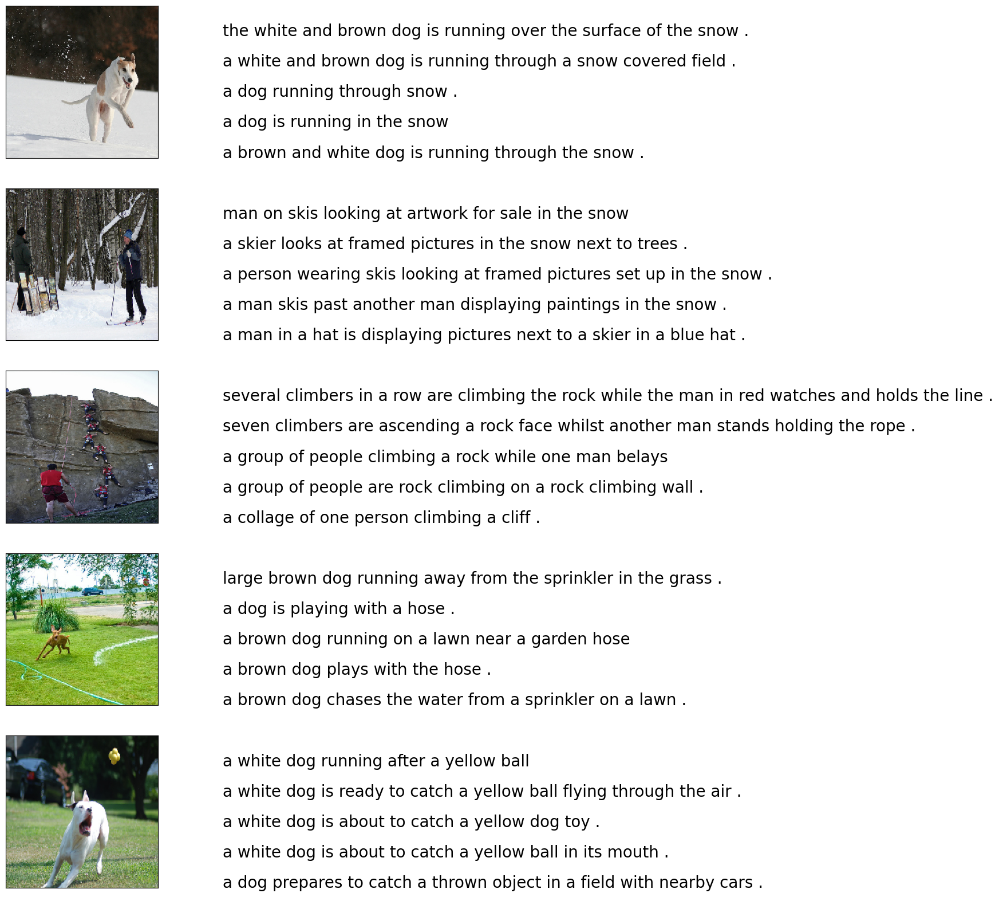

In [8]:
# Import necessary functions for image preprocessing
# from keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.preprocessing.image import load_img, img_to_array

# Define parameters for displaying images and processing
npic = 5  # Number of images to display
npix = 224  # Pixel size for target image resizing
target_size = (npix, npix, 3)  # Target size for image preprocessing

# Initialize a count for subplot placement
count = 1

# Create a new figure for displaying images and captions
fig = plt.figure(figsize=(10, 20))

# Iterate through selected filenames and their captions
for jpgfnm in uni_filenames[10:15]:
    # Construct the full image file path
    filename = image_path + '/' + jpgfnm

    # Retrieve captions for the current image filename
    captions = list(data["caption"].loc[data["filename"] == jpgfnm].values)

    # Load and preprocess the image
    image_load = load_img(filename, target_size=target_size)

    # Add the image to the subplot grid
    ax = fig.add_subplot(npic, 2, count, xticks=[], yticks=[])
    ax.imshow(image_load)
    count += 1

    # Add a subplot for displaying captions
    ax = fig.add_subplot(npic, 2, count)
    plt.axis('off')
    ax.plot()
    ax.set_xlim(0, 1)
    ax.set_ylim(0, len(captions))

    # Display each caption below the corresponding subplot
    for i, caption in enumerate(captions):
        ax.text(0, i, caption, fontsize=20)
    count += 1

# Show the figure with images and captions
plt.show()


In [9]:
# Calculate Vocabulary Size
vocabulary = []
for words in data.caption.values:
    vocabulary.extend(words.split())
vocabulary_size = len(set(vocabulary))
print('Vocabulary Size:', vocabulary_size)


Vocabulary Size: 8918


In [10]:
# Extracting Image Filenames and Captions from DataFrame
img_filenames = data["filename"].tolist()  # List of image filenames
captions = data["caption"].tolist()        # List of corresponding captions


In [11]:
#8091*5
print(f"len(img) : {len(img_filenames)}")
print(f"len(caption) : {len(captions)}")

len(img) : 40455
len(caption) : 40455


In [12]:
# Text Preprocessing Functions

# Function to remove punctuations from a given text
def clean_punctuation(text):
    clean_text = text.translate(str.maketrans('', '', string.punctuation))
    return clean_text

# Function to remove single characters from a given text
def clean_single_character(text):
    long_text = ""
    for word in text.split():
        if len(word) > 1:
            long_text += " " + word
    return long_text

# Function to remove numeric values from a given text
def clean_numeric(text):
    only_text = ""
    for word in text.split():
        is_alpha = word.isalpha()
        if is_alpha:
            only_text += " " + word
    return only_text


In [13]:
# Clean and preprocess the captions in the DataFrame

def clean_text(text):
    clean_text = clean_punctuation(text)
    clean_text = clean_single_character(clean_text)
    clean_text = clean_numeric(clean_text)
    return text

# Loop through each caption in the DataFrame and preprocess it
for i, caption in enumerate(data.caption.values):
    new_caption = clean_text(caption)
    data["caption"].iloc[i] = new_caption


In [14]:
# Initialize a list to store the filtered vocabulary
filtered_vocabulary = []

# Loop through each caption in the data
for txt in data.caption.values:
    # Split the caption into individual words and extend the filtered vocabulary list
    filtered_vocabulary.extend(txt.split())

# Calculate and print the size of the filtered vocabulary
print('Filtered Vocabulary Size: %d' % len(set(filtered_vocabulary)))


Filtered Vocabulary Size: 8918


In [15]:
# Define the path to the image dataset
PATH = "/content/drive/MyDrive/attention_model/Flicker8k_Dataset/"

# Initialize a list to store all modified captions
all_captions = []

# Loop through each caption in the data
for caption in data["caption"].astype(str):
    # Add <start> and <end> tokens to the caption
    caption = '<start> ' + caption + ' <end>'

    # Append the modified caption to the list
    all_captions.append(caption)

# Print the first 10 modified captions
print(all_captions[:10])


['<start> a child in a pink dress is climbing up a set of stairs in an entry way . <end>', '<start> a girl going into a wooden building . <end>', '<start> a little girl climbing into a wooden playhouse . <end>', '<start> a little girl climbing the stairs to her playhouse . <end>', '<start> a little girl in a pink dress going into a wooden cabin . <end>', '<start> a black dog and a spotted dog are fighting <end>', '<start> a black dog and a tri-colored dog playing with each other on the road . <end>', '<start> a black dog and a white dog with brown spots are staring at each other in the street . <end>', '<start> two dogs of different breeds looking at each other on the road . <end>', '<start> two dogs on pavement moving toward each other . <end>']


In [16]:
# Initialize a list to store all image paths
all_img_name_vector = []

# Loop through each annotation in the data
for annot in data["filename"]:
    # Create the full image path using the specified path and annotation
    full_image_path = PATH + annot

    # Append the image path to the list
    all_img_name_vector.append(full_image_path)

# Print the first 10 image paths
print(all_img_name_vector[:10])


['/content/drive/MyDrive/attention_model/Flicker8k_Dataset/1000268201_693b08cb0e.jpg', '/content/drive/MyDrive/attention_model/Flicker8k_Dataset/1000268201_693b08cb0e.jpg', '/content/drive/MyDrive/attention_model/Flicker8k_Dataset/1000268201_693b08cb0e.jpg', '/content/drive/MyDrive/attention_model/Flicker8k_Dataset/1000268201_693b08cb0e.jpg', '/content/drive/MyDrive/attention_model/Flicker8k_Dataset/1000268201_693b08cb0e.jpg', '/content/drive/MyDrive/attention_model/Flicker8k_Dataset/1001773457_577c3a7d70.jpg', '/content/drive/MyDrive/attention_model/Flicker8k_Dataset/1001773457_577c3a7d70.jpg', '/content/drive/MyDrive/attention_model/Flicker8k_Dataset/1001773457_577c3a7d70.jpg', '/content/drive/MyDrive/attention_model/Flicker8k_Dataset/1001773457_577c3a7d70.jpg', '/content/drive/MyDrive/attention_model/Flicker8k_Dataset/1001773457_577c3a7d70.jpg']


In [17]:
# Print the total number of image paths in the all_img_name_vector list
print(f"len(all_img_name_vector) : {len(all_img_name_vector)}")

# Print the total number of captions in the all_captions list
print(f"len(all_captions) : {len(all_captions)}")


len(all_img_name_vector) : 40455
len(all_captions) : 40455


In [18]:
def data_limiter(num, total_captions, all_img_name_vector):
    """
    Limit the data to a specified number of samples.

    Args:
        num (int): Number of samples to keep.
        total_captions (list): List of captions.
        all_img_name_vector (list): List of image paths.

    Returns:
        list: Limited list of captions.
        list: Limited list of image paths.
    """
    # Shuffle the captions and image paths
    train_captions, img_name_vector = shuffle(total_captions, all_img_name_vector, random_state=1)

    # Keep only the first 'num' samples
    train_captions = train_captions[:num]
    img_name_vector = img_name_vector[:num]

    return train_captions, img_name_vector


In [19]:
# Limit the data to a specific number of samples (e.g., 40000)
train_captions, img_name_vector = data_limiter(40000, all_captions, all_img_name_vector)


In [20]:
print(f"len(all_img_name_vector) : {len(img_name_vector)}")
print(f"len(all_captions) : {len(train_captions)}")

len(all_img_name_vector) : 40000
len(all_captions) : 40000


In [21]:
def load_image(image_path):
    # Read image file
    img = tf.io.read_file(image_path)

    # Decode image and resize
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, (224, 224))

    # Preprocess the image
    img = preprocess_input(img)

    return img, image_path


In [22]:
# Load a pre-trained VGG16 model without the top classification layer
image_model = tf.keras.applications.VGG16(include_top=False, weights='imagenet')

# Get the input layer of the VGG16 model
new_input = image_model.input

# Get the output of the last hidden layer of the VGG16 model
hidden_layer = image_model.layers[-1].output

# Create a new model that takes the input and outputs the extracted image features
image_features_extract_model = tf.keras.Model(new_input, hidden_layer)


58889256/58889256 [==============================] - 0s 0us/step


In [23]:
image_features_extract_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, None, None, 3)]   0         
                                                                 
 block1_conv1 (Conv2D)       (None, None, None, 64)    1792      
                                                                 
 block1_conv2 (Conv2D)       (None, None, None, 64)    36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, None, None, 64)    0         
                                                                 
 block2_conv1 (Conv2D)       (None, None, None, 128)   73856     
                                                                 
 block2_conv2 (Conv2D)       (None, None, None, 128)   147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, None, None, 128)   0     

In [24]:
# Create a sorted set of unique image names
encode_train = sorted(set(img_name_vector))

# Create a TensorFlow Dataset from the image names
image_dataset = tf.data.Dataset.from_tensor_slices(encode_train)

# Use the load_image function to load and preprocess images in parallel
image_dataset = image_dataset.map(load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE)

# Batch the preprocessed images
image_dataset = image_dataset.batch(32)


In [ ]:
%%time
# Iterate through the image dataset and process images in batches
for img, path in tqdm(image_dataset):
    # Extract image features using the image_features_extract_model
    batch_features = image_features_extract_model(img)

    # Reshape and save extracted features for each image in the batch
    batch_features = tf.reshape(batch_features,
                                (batch_features.shape[0], -1, batch_features.shape[3]))

    for bf, p in zip(batch_features, path):
        path_of_feature = p.numpy().decode("utf-8")
        # Save extracted features as a NumPy array in a file
        np.save(path_of_feature, bf.numpy())


In [25]:
# Choose the top 5000 words from the vocabulary
top_k = 5000

# Initialize the Tokenizer with specified parameters
tokenizer = tf.keras.preprocessing.text.Tokenizer(num_words=top_k,
                                                  oov_token="<unk>",
                                                  filters='!"#$%&()*+.,-/:;=?@[\]^_`{|}~ ')

# Fit the tokenizer on the training captions to build the vocabulary
tokenizer.fit_on_texts(train_captions)

# Add padding tokens to the vocabulary mappings
tokenizer.word_index['<pad>'] = 0
tokenizer.index_word[0] = '<pad>'

# Convert the training captions to sequences of integers using the tokenizer
train_seqs = tokenizer.texts_to_sequences(train_captions)

# Pad each sequence to the max_length of the captions
# If max_length is not specified, pad_sequences calculates it automatically
cap_vector = tf.keras.preprocessing.sequence.pad_sequences(train_seqs, padding='post')


In [26]:
# Calculate the maximum length among all the tokenized sequences
def calc_max_length(tensor):
    return max(len(t) for t in tensor)

max_length = calc_max_length(train_seqs)

# Calculate the minimum length among all the tokenized sequences
def calc_min_length(tensor):
    return min(len(t) for t in tensor)

min_length = calc_min_length(train_seqs)

# Print the maximum and minimum lengths of captions
print('Max Length of any caption : Min Length of any caption = ' + str(max_length) + " : " + str(min_length))


Max Length of any caption : Min Length of any caption = 39 : 3


In [27]:
# Split the dataset into training and testing sets
# img_name_train: List of image paths for training
# img_name_test: List of image paths for testing
# cap_train: Tokenized and padded captions for training
# cap_test: Tokenized and padded captions for testing
img_name_train, img_name_test, cap_train, cap_test = train_test_split(img_name_vector, cap_vector, test_size=0.2, random_state=0)


In [28]:
# Function to get the image ID from the image path
def get_image_id(image_path):
    image_filename = image_path.split("/")[-1]  # Extract the filename from the path
    image_id = image_filename.split(".")[0]  # Remove the file extension to get the ID
    return image_id


In [29]:
# Import the pandas library
import pandas as pd

# Create a DataFrame to store the image IDs of the testing set
results_df = pd.DataFrame({
    'Image_ID': [get_image_id(image_path) for image_path in img_name_test]
})

# Save the DataFrame to a CSV file named 'image_name_test.csv'
results_df.to_csv('image_name_test.csv', index=False)

# Display the first few rows of the DataFrame
print(results_df.head())

# Print the number of rows in the DataFrame
print("Number of rows in the DataFrame:", len(results_df))


                Image_ID
0  2352414953_10f3cd0f1f
1  3081182021_22cfa18dd4
2  3104909823_0f41dd8be6
3  2956413620_d59de03a06
4  1501297480_8db52c15b0
Number of rows in the DataFrame: 8000


In [30]:
# Set the batch size for training
BATCH_SIZE = 64

# Set the buffer size for shuffling the dataset
BUFFER_SIZE = 1000

# Define the embedding dimension
embedding_dim = 256

# Define the number of units for the LSTM layer
units = 512

# Calculate the vocabulary size by adding 1 to the length of the word index in the tokenizer
vocab_size = len(tokenizer.word_index) + 1

# Calculate the number of steps per epoch by dividing the number of training images by the batch size
num_steps = len(img_name_train) // BATCH_SIZE

# Define the shape of the image features extracted by the VGG-16 model
features_shape = 512

# Define the shape of the attention features
attention_features_shape = 49


In [31]:
# Define a function to load the numpy files
def map_func(img_name, cap):
    img_tensor = np.load(img_name.decode('utf-8') + '.npy')
    return img_tensor, cap

# Create a dataset from tensor slices of image names and captions
dataset = tf.data.Dataset.from_tensor_slices((img_name_train, cap_train))

# Use the map function to load the numpy files in parallel
dataset = dataset.map(lambda item1, item2: tf.numpy_function(
    map_func, [item1, item2], [tf.float32, tf.int32]),
    num_parallel_calls=tf.data.experimental.AUTOTUNE)

# Shuffle and batch the dataset
dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

# Prefetch the dataset for improved performance
dataset = dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)


In [32]:
class VGG16_Encoder(tf.keras.Model):
    def __init__(self, embedding_dim):
        super(VGG16_Encoder, self).__init__()
        # Fully connected layer to transform features
        self.fc = tf.keras.layers.Dense(embedding_dim)
        # Dropout layer for regularization
        self.dropout = tf.keras.layers.Dropout(0.5, noise_shape=None, seed=None)

    def call(self, x):
        # Pass the input through the fully connected layer
        x = self.fc(x)
        # Apply ReLU activation
        x = tf.nn.relu(x)
        return x


In [33]:
def rnn_type(units):
    # Check if GPU is available
    if tf.test.is_gpu_available():
        # Use CuDNNLSTM for faster GPU processing
        return tf.compat.v1.keras.layers.CuDNNLSTM(units,
                                                   return_sequences=True,
                                                   return_state=True,
                                                   recurrent_initializer='glorot_uniform')
    else:
        # Use GRU if GPU is not available
        return tf.keras.layers.GRU(units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_activation='sigmoid',
                                   recurrent_initializer='glorot_uniform')


In [34]:


class Rnn_Local_Decoder(tf.keras.Model):
    def __init__(self, embedding_dim, units, vocab_size):
        super(Rnn_Local_Decoder, self).__init__()
        self.units = units

        # Embedding layer
        self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)

        # GRU layer
        self.gru = tf.keras.layers.GRU(self.units,
                                       return_sequences=True,
                                       return_state=True,
                                       recurrent_initializer='glorot_uniform')

        # Fully connected layers
        self.fc1 = tf.keras.layers.Dense(units, kernel_regularizer=l2(0.01))

        # Dropout layer
        self.dropout = tf.keras.layers.Dropout(0.5, noise_shape=None, seed=None)

        # BatchNormalization layer
        self.batchnormalization = tf.keras.layers.BatchNormalization(axis=-1, momentum=0.99, epsilon=0.001, center=True, scale=True, beta_initializer='zeros', gamma_initializer='ones', moving_mean_initializer='zeros', moving_variance_initializer='ones', beta_regularizer=None, gamma_regularizer=None, beta_constraint=None, gamma_constraint=None)

        # Output layer
        self.fc2 = tf.keras.layers.Dense(vocab_size)

        # Attention mechanism layers
        self.Uattn = tf.keras.layers.Dense(units)
        self.Wattn = tf.keras.layers.Dense(units)
        self.Vattn = tf.keras.layers.Dense(1)

    def call(self, x, features, hidden):
        hidden_with_time_axis = tf.expand_dims(hidden, 1)

        # Attention score calculation
        score = self.Vattn(tf.nn.tanh(self.Uattn(features) + self.Wattn(hidden_with_time_axis)))

        # Attention weights using softmax
        attention_weights = tf.nn.softmax(score, axis=1)

        # Calculating context vector using attention weights and features
        context_vector = attention_weights * features
        context_vector = tf.reduce_sum(context_vector, axis=1)

        # Embedding input and concatenating context vector
        x = self.embedding(x)
        x = tf.concat([tf.expand_dims(context_vector, 1), x], axis=-1)

        # Passing concatenated vector through the GRU
        output, state = self.gru(x)

        # Fully connected layer
        x = self.fc1(output)
        x = tf.reshape(x, (-1, x.shape[2]))

        # Applying Dropout and BatchNormalization
        x = self.dropout(x)
        x = self.batchnormalization(x)

        # Output prediction
        x = self.fc2(x)
        return x, state, attention_weights

    def reset_state(self, batch_size):
        return tf.zeros((batch_size, self.units))


In [35]:
# Create the VGG16-based encoder and the attention-based RNN decoder
encoder = VGG16_Encoder(embedding_dim)
decoder = Rnn_Local_Decoder(embedding_dim, units, vocab_size)


In [36]:
# Define the optimizer, loss object, and loss function for the model
optimizer = tf.keras.optimizers.Adam(0.001)
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(
    from_logits=True, reduction='none')

def loss_function(real, pred):
    # Create a mask to ignore padding tokens
    mask = tf.math.logical_not(tf.math.equal(real, 0))

    # Apply the loss function to the actual and predicted values
    loss_ = loss_object(real, pred)

    # Apply the mask to the loss values
    mask = tf.cast(mask, dtype=loss_.dtype)
    loss_ *= mask

    # Calculate the mean loss over non-padded tokens
    return tf.reduce_mean(loss_)


In [37]:
loss_plot = []

@tf.function
def train_step(img_tensor, target):
    loss = 0

    # Initializing the hidden state for each batch
    # because the captions are not related from image to image
    hidden = decoder.reset_state(batch_size=target.shape[0])

    # Start token as initial input to the decoder
    dec_input = tf.expand_dims([tokenizer.word_index['<start>']] * BATCH_SIZE, 1)

    with tf.GradientTape() as tape:
        # Pass the image through the encoder to get features
        features = encoder(img_tensor)

        for i in range(1, target.shape[1]):
            # Pass the features and previous decoder output through the decoder
            predictions, hidden, _ = decoder(dec_input, features, hidden)

            # Calculate loss for this step and add it to the total loss
            loss += loss_function(target[:, i], predictions)

            # Use teacher forcing by using the actual target as the next input
            dec_input = tf.expand_dims(target[:, i], 1)

    # Calculate total loss by averaging over sequence length
    total_loss = (loss / int(target.shape[1]))

    # Get the trainable variables from both the encoder and decoder
    trainable_variables = encoder.trainable_variables + decoder.trainable_variables

    # Calculate gradients and apply them using the optimizer
    gradients = tape.gradient(loss, trainable_variables)
    optimizer.apply_gradients(zip(gradients, trainable_variables))

    return loss, total_loss


In [38]:
EPOCHS = 25
start_epoch = 0

# Loop through the epochs
for epoch in range(start_epoch, EPOCHS):
    start = time.time()
    total_loss = 0

    # Iterate through each batch of the dataset
    for (batch, (img_tensor, target)) in enumerate(dataset):
        try:
            # Perform a training step for the batch
            batch_loss, t_loss = train_step(img_tensor, target)
            total_loss += t_loss

            # Print loss for every 100 batches
            if batch % 100 == 0:
                print ('Epoch {} Batch {} Loss {:.4f}'.format(
                    epoch + 1, batch, batch_loss.numpy() / int(target.shape[1])))

        except FileNotFoundError as e:
            # Skip image and continue in case of FileNotFoundError
            print(f"Skipping image due to error: {e}")
            continue

    # Store the epoch end loss value for plotting
    loss_plot.append(total_loss / num_steps)

    # Print epoch summary
    print ('Epoch {} Loss {:.6f}'.format(epoch + 1, total_loss / num_steps))
    print ('Time taken for 1 epoch {} sec\n'.format(time.time() - start))


Epoch 1 Batch 0 Loss 2.8892
Epoch 1 Batch 100 Loss 1.5594
Epoch 1 Batch 200 Loss 1.2936
Epoch 1 Batch 300 Loss 1.2817
Epoch 1 Batch 400 Loss 1.1098
Epoch 1 Loss 1.320304
Time taken for 1 epoch 1924.4558353424072 sec

Epoch 2 Batch 0 Loss 1.1346
Epoch 2 Batch 100 Loss 1.0325
Epoch 2 Batch 200 Loss 0.9860
Epoch 2 Batch 300 Loss 1.0132
Epoch 2 Batch 400 Loss 0.9985
Epoch 2 Loss 1.007379
Time taken for 1 epoch 76.85546684265137 sec

Epoch 3 Batch 0 Loss 0.9397
Epoch 3 Batch 100 Loss 0.9993
Epoch 3 Batch 200 Loss 0.9851
Epoch 3 Batch 300 Loss 1.0527
Epoch 3 Batch 400 Loss 0.8363
Epoch 3 Loss 0.906064
Time taken for 1 epoch 75.20882415771484 sec

Epoch 4 Batch 0 Loss 0.8101
Epoch 4 Batch 100 Loss 0.7869
Epoch 4 Batch 200 Loss 0.8472
Epoch 4 Batch 300 Loss 0.8469
Epoch 4 Batch 400 Loss 0.7297
Epoch 4 Loss 0.833880
Time taken for 1 epoch 74.28770923614502 sec

Epoch 5 Batch 0 Loss 0.6922
Epoch 5 Batch 100 Loss 0.7575
Epoch 5 Batch 200 Loss 0.7621
Epoch 5 Batch 300 Loss 0.6966
Epoch 5 Batch 400

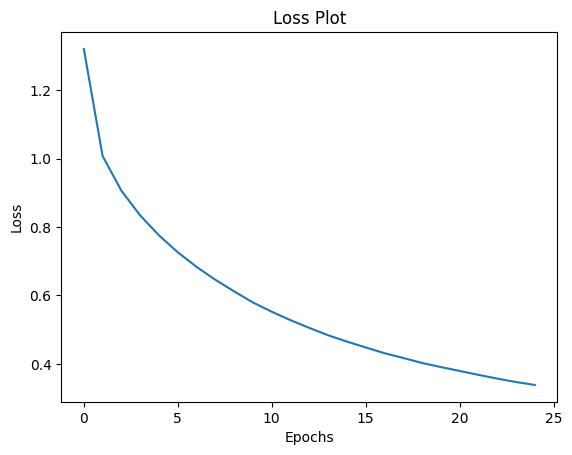

In [39]:
plt.plot(loss_plot)
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss Plot')
plt.show()

In [40]:
def evaluate(image):
    # Reset the decoder's hidden state for a new caption generation
    hidden = decoder.reset_state(batch_size=1)

    # Preprocess the input image and extract features
    temp_input = tf.expand_dims(load_image(image)[0], 0)
    img_tensor_val = image_features_extract_model(temp_input)
    img_tensor_val = tf.reshape(img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3]))
    features = encoder(img_tensor_val)

    # Initialize the decoder input with the start token
    dec_input = tf.expand_dims([tokenizer.word_index['<start>']], 0)
    result = []

    # Generate words for the caption
    for i in range(max_length):
        predictions, hidden, _ = decoder(dec_input, features, hidden)

        predicted_id = tf.argmax(predictions[0]).numpy()
        result.append(tokenizer.index_word[predicted_id])

        if tokenizer.index_word[predicted_id] == '<end>':
            return result

        # Prepare the input for the next time step
        dec_input = tf.expand_dims([predicted_id], 0)

    return result


In [ ]:
import random

# Select 50 random indices from img_name_test
random_indices = random.sample(range(len(img_name_test)), 50)

# Iterate through the selected random indices
for i in random_indices:
    # Get the image path, image ID, and corresponding ground truth caption
    image_path = img_name_test[i]
    image_id = image_path.split('/')[-1].split('.')[0]
    actual_caption = ' '.join([tokenizer.index_word[word_idx] for word_idx in cap_test[i] if word_idx not in [0]])

    # Print the image ID, image path, actual caption
    print(f"Image {image_id} - Image Path: {image_path} - Actual Caption: {actual_caption}")


In [47]:
import random
import pandas as pd
from PIL import Image


# Select 50 random indices from img_name_test
random_indices = random.sample(range(len(img_name_test)), 50)

# Create lists to store the data for the DataFrame
image_ids = []
result_image_paths = []
actual_captions = []

# Iterate through the randomly selected indices
for i in random_indices:
    image_path = img_name_test[i]
    image_id = image_path.split('/')[-1].split('.')[0]
    actual_caption = ' '.join([tokenizer.index_word[word_idx] for word_idx in cap_test[i] if word_idx not in [0]])

    # Append the data to the lists
    image_ids.append(image_id)
    result_image_paths.append(image_path)
    actual_captions.append(actual_caption)

    # Print image details
    print(f"Image {image_id} - Image Path: {image_path} - Actual Caption: {actual_caption}")

# Create a DataFrame to store the results
results_df = pd.DataFrame({
    'Image_ID': image_ids,
    'Image_Path': result_image_paths,
    'Actual_Caption': actual_captions
})

# Save the DataFrame as a CSV file
results_df.to_csv('random_images_data.csv', index=False)

# Provide download information
print("CSV file containing random image data saved successfully!")
print("Click the link below to download the CSV file:")
print("Download Link: /content/random_images_data.csv")


Image 3249014584_21dd9ddd9d - Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3249014584_21dd9ddd9d.jpg - Actual Caption: <start> a man has a chainsaw and is carving a block of ice <end>
Image 2721656220_5f4cda8bc1 - Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2721656220_5f4cda8bc1.jpg - Actual Caption: <start> a woman holds a drink and smiles <end>
Image 124972799_de706b6d0b - Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/124972799_de706b6d0b.jpg - Actual Caption: <start> black and brown dog growling at brown cat hiding under wooden bench <end>
Image 391020801_aaaae1e42b - Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/391020801_aaaae1e42b.jpg - Actual Caption: <start> a man in a white shirt holding both hands out <end>
Image 2507312812_768b53b023 - Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2507312812_768b53b023.jpg - Actual Caption: <start> a black dog is chasing anot

In [48]:
# Load the random_image_datset.csv file into a DataFrame
csv_file_path = '/content/drive/MyDrive/random_images_data (1).csv'  # Replace with the actual path to your CSV file
random_testimage_df = pd.read_csv(csv_file_path)

Image ID: 2867937005_91c092b157
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2867937005_91c092b157.jpg
Actual Caption: <start> girl in pick dress stands upside down <end>
Predicted Caption: <start> a young girl in a pink dress is standing in a pink dress is standing in a pink dress is standing in a pink dress is standing in a pink dress is standing in a pink dress is standing
METEOR score: 0.12738853503184713
BLEU score as percentage: 0.00%
----------------------


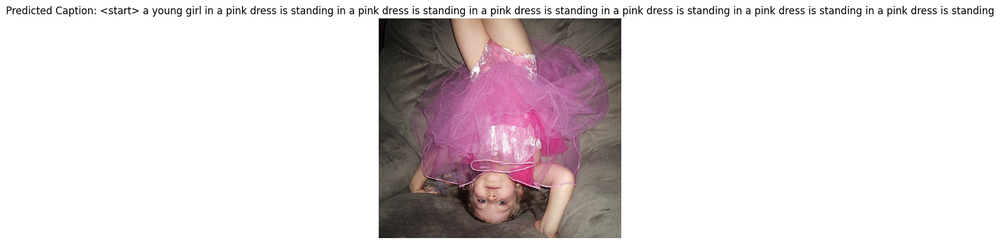

Image ID: 226607225_44d696db6b
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/226607225_44d696db6b.jpg
Actual Caption: <start> the large green fish is jumping out of the water <end>
Predicted Caption: <start> a large green water < unk > water < end >
METEOR score: 0.48076923076923084
BLEU score as percentage: 19.41%
----------------------


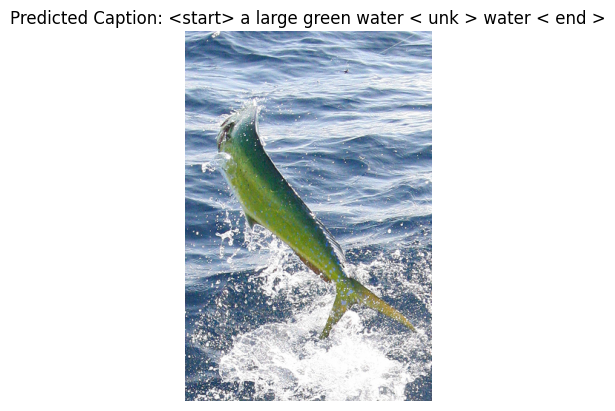

Image ID: 481054596_cad8c02103
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/481054596_cad8c02103.jpg
Actual Caption: <start> the man in the red shirt is taking picture of the two people hugging <end>
Predicted Caption: <start> a man and a woman hug on a city < end >
METEOR score: 0.23108808290155444
BLEU score as percentage: 0.00%
----------------------


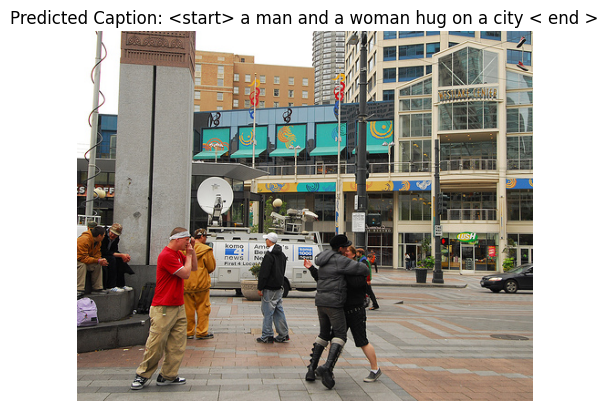

Image ID: 3044500219_778f9f2b71
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3044500219_778f9f2b71.jpg
Actual Caption: <start> four girls in evening wear are posing for photograph <end>
Predicted Caption: <start> four women pose together posing for the camera < end >
METEOR score: 0.38265306122448983
BLEU score as percentage: 0.00%
----------------------


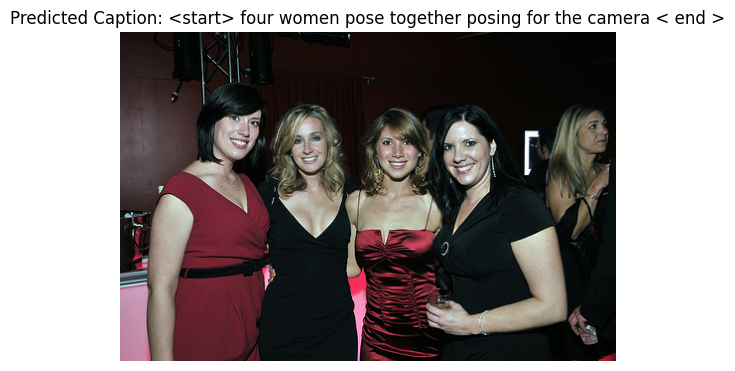

Image ID: 508929192_670910fdd2
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/508929192_670910fdd2.jpg
Actual Caption: <start> children are playing badminton in the garden <end>
Predicted Caption: <start> two boys hold badminton on the lawn < end >
METEOR score: 0.34843750000000007
BLEU score as percentage: 0.00%
----------------------


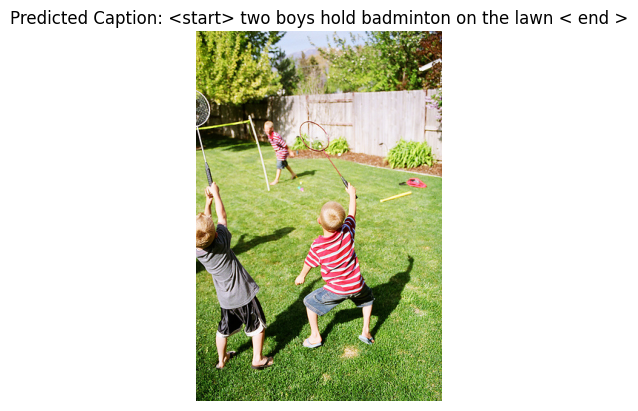

Image ID: 284279868_2ca98e3dcd
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/284279868_2ca98e3dcd.jpg
Actual Caption: <start> two dogs play in field of snow <end>
Predicted Caption: <start> two dogs play in the snow < end >
METEOR score: 0.625
BLEU score as percentage: 38.92%
----------------------


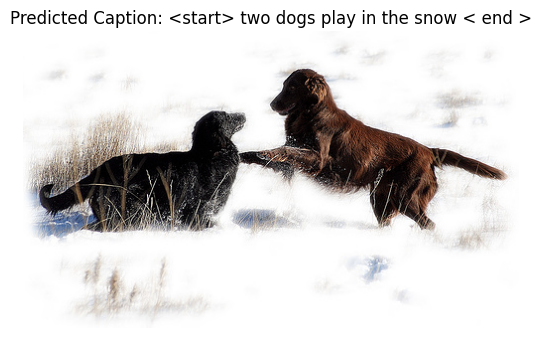

Image ID: 1775029934_e1e96038a8
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/1775029934_e1e96038a8.jpg
Actual Caption: <start> an <unk> runs through tall brown grass <end>
Predicted Caption: <start> a wild dog races across an uncut field with a minimal amount of trees < end >
METEOR score: 0.29150326797385623
BLEU score as percentage: 0.00%
----------------------


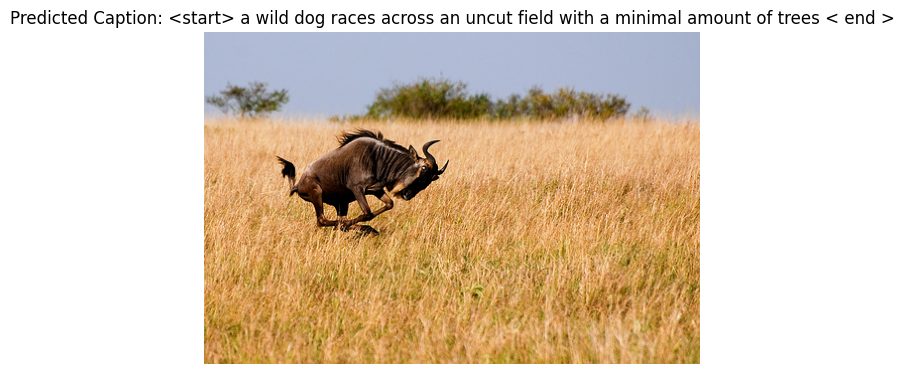

Image ID: 2358554995_54ed3baa83
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2358554995_54ed3baa83.jpg
Actual Caption: <start> child is holding on to the top of playground slide <end>
Predicted Caption: <start> a toddler all bundled up two straps riding a climbing a slide < end >
METEOR score: 0.248046875
BLEU score as percentage: 15.31%
----------------------


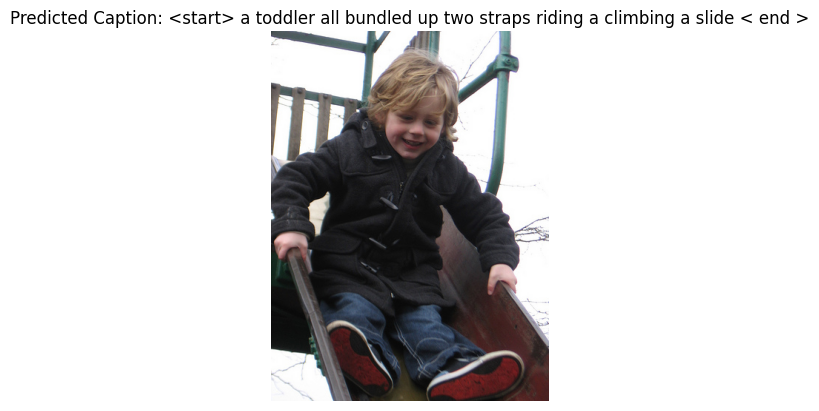

Image ID: 3262760716_1e9734f5ba
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3262760716_1e9734f5ba.jpg
Actual Caption: <start> man holds baby which is chewing on eyeglasses <end>
Predicted Caption: <start> a man is scratching his head is eating a picture of a picture of a picture of a picture of a picture of a picture of a picture of a picture of a picture of a picture of a
METEOR score: 0.09036144578313253
BLEU score as percentage: 0.00%
----------------------


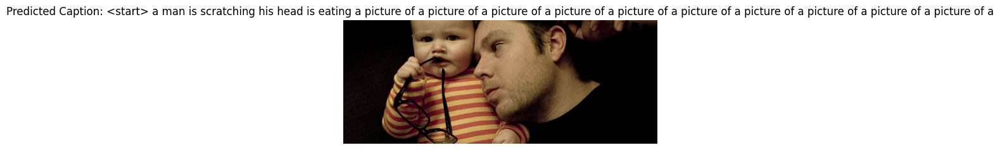

Image ID: 2450299735_62c095f40e
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2450299735_62c095f40e.jpg
Actual Caption: <start> little girl in white shirt sliding down green slide splashing into blue baby pool <end>
Predicted Caption: <start> a little girl plays in a pool < end >
METEOR score: 0.35206752858211343
BLEU score as percentage: 12.79%
----------------------


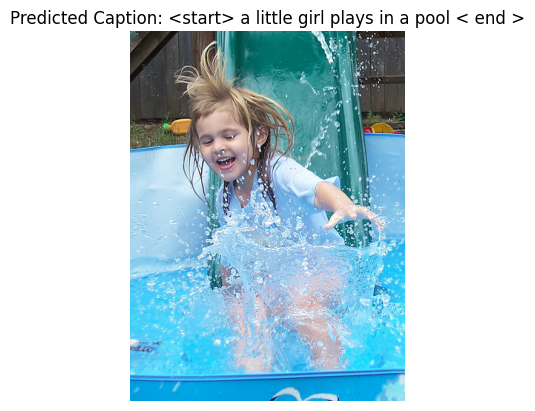

Image ID: 3449718979_e987c64e2d
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3449718979_e987c64e2d.jpg
Actual Caption: <start> brown dog is walking down steps <end>
Predicted Caption: <start> a dog runs through a hole < end >
METEOR score: 0.3177966101694915
BLEU score as percentage: 0.00%
----------------------


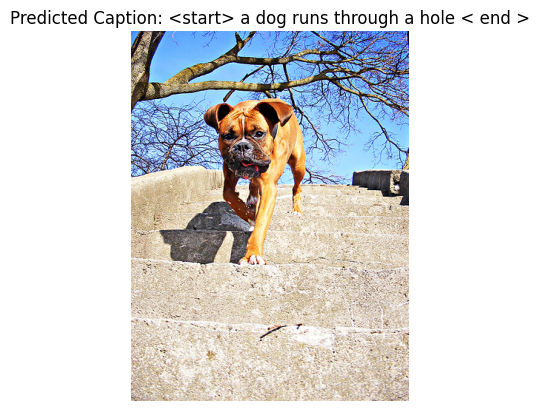

Image ID: 436009777_440c7679a1
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/436009777_440c7679a1.jpg
Actual Caption: <start> two people sitting on rock in city park <end>
Predicted Caption: <start> three people sit on a big city street < end >
METEOR score: 0.48728186926944694
BLEU score as percentage: 0.00%
----------------------


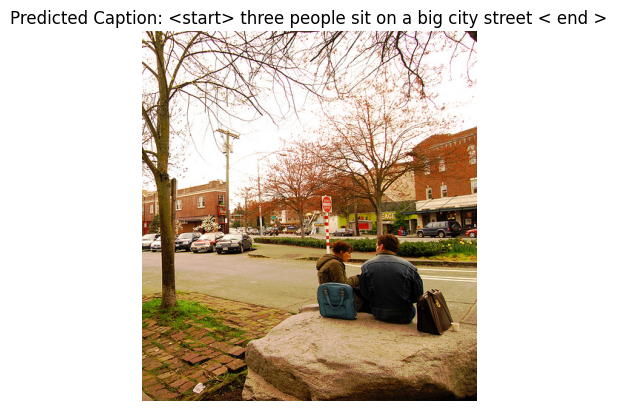

Image ID: 2618538137_44fffe10c4
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2618538137_44fffe10c4.jpg
Actual Caption: <start> man on skateboard poses with dog <end>
Predicted Caption: <start> a brown and white dog is squatting next to a dog < end >
METEOR score: 0.32266260162601623
BLEU score as percentage: 16.45%
----------------------


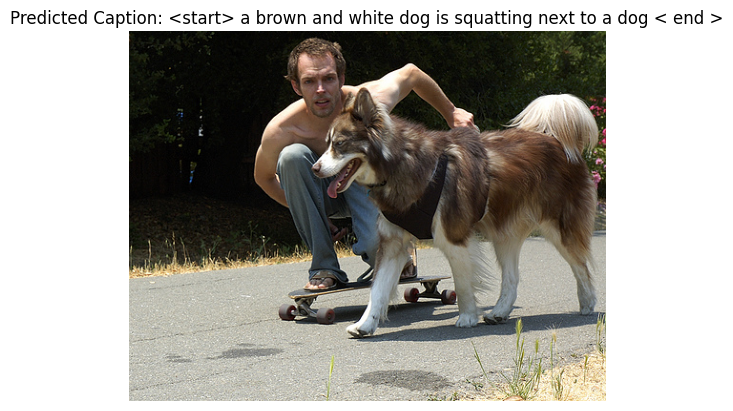

Image ID: 3186412658_2ab2ebd397
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3186412658_2ab2ebd397.jpg
Actual Caption: <start> group of woman hold each other up to catch ball <end>
Predicted Caption: <start> a man jumping into the air to catch a ball < end >
METEOR score: 0.42560061999483334
BLEU score as percentage: 18.33%
----------------------


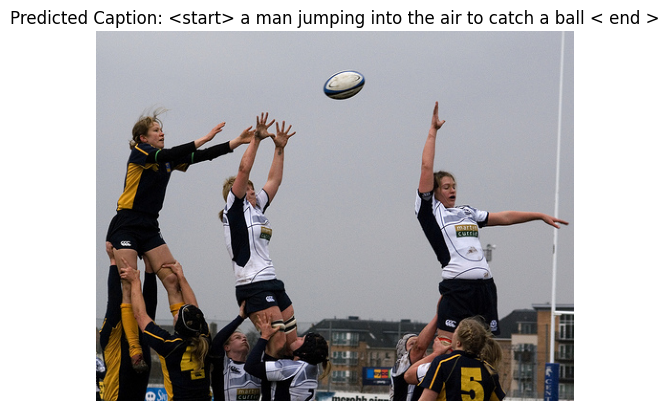

Image ID: 109823397_e35154645f
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/109823397_e35154645f.jpg
Actual Caption: <start> person dressed in tan jacket jumps quad over <unk> <unk> in front of small out building <end>
Predicted Caption: <start> a man on a four wheeler in the air < end >
METEOR score: 0.15182186234817813
BLEU score as percentage: 0.00%
----------------------


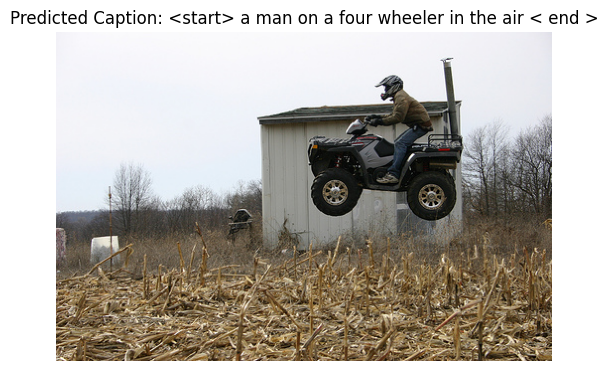

Image ID: 344078103_4b23931ce5
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/344078103_4b23931ce5.jpg
Actual Caption: <start> two black dogs play in snow <end>
Predicted Caption: <start> two black dogs run through the snow < end >
METEOR score: 0.6670168067226891
BLEU score as percentage: 30.98%
----------------------


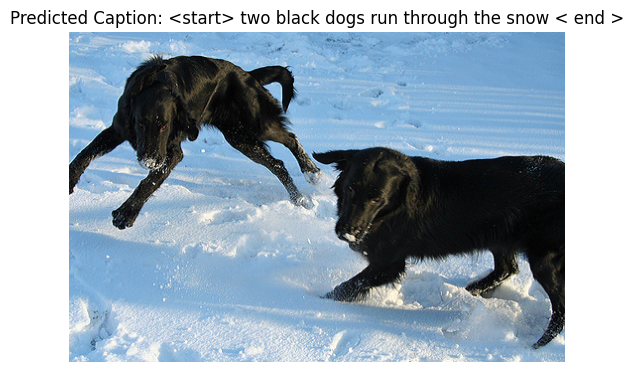

Image ID: 263216826_acf868049c
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/263216826_acf868049c.jpg
Actual Caption: <start> the couple is sitting on rock overlooking valley <end>
Predicted Caption: <start> a man and a woman in a tank top sitting on a rock and trees < end >
METEOR score: 0.3879310344827587
BLEU score as percentage: 0.00%
----------------------


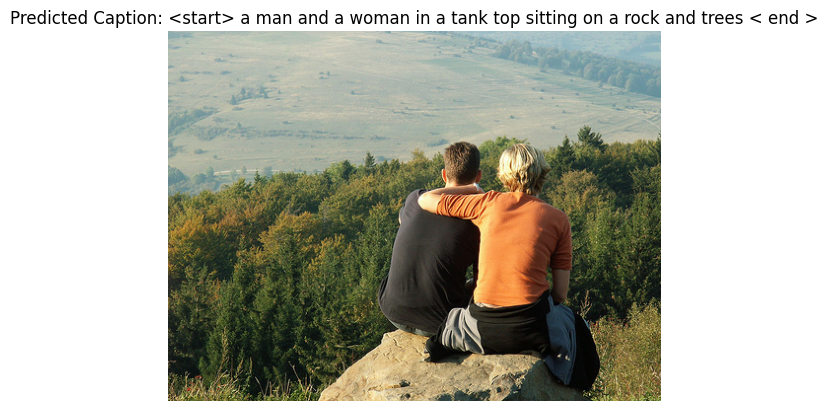

Image ID: 2050067751_22d2763fd2
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2050067751_22d2763fd2.jpg
Actual Caption: <start> the small child in green crocks leans over to look inside <unk> <end>
Predicted Caption: <start> a little girl plays on a < unk > < end >
METEOR score: 0.31016119746689697
BLEU score as percentage: 22.21%
----------------------


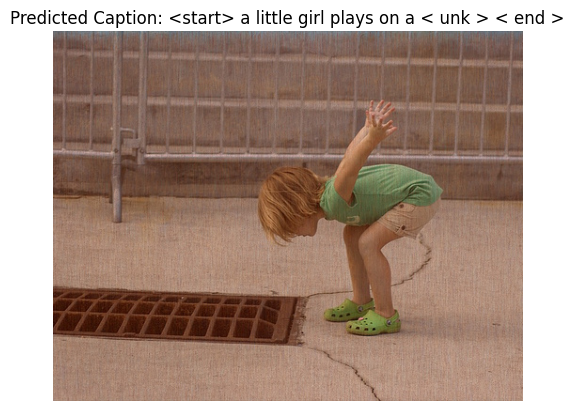

Image ID: 3583293892_c96af8cd98
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3583293892_c96af8cd98.jpg
Actual Caption: <start> baseball is being played by two men in red jerseys by <unk> sign <end>
Predicted Caption: <start> two baseball pitcher in a red and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and
METEOR score: 0.08733624454148471
BLEU score as percentage: 0.00%
----------------------


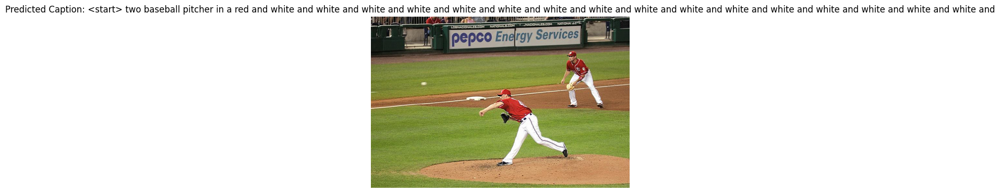

Image ID: 3530342993_a4a1f0e516
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3530342993_a4a1f0e516.jpg
Actual Caption: <start> bicycler is going down ramp at bike festival <end>
Predicted Caption: <start> a stunt cyclist launches himself flying off a bicycle goes down a bike flies through a line of cyclists ride off a bicycle goes down a bike flies through a line of cyclists ride off a bicycle goes down
METEOR score: 0.09036144578313253
BLEU score as percentage: 0.00%
----------------------


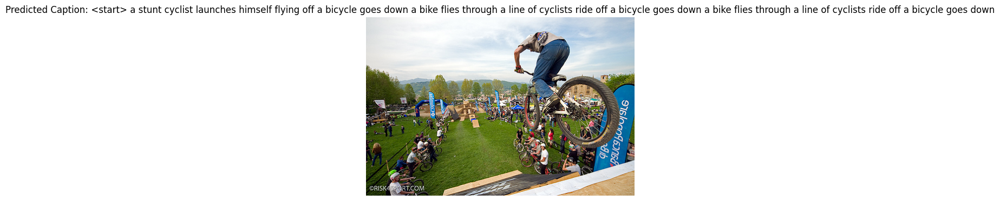

Image ID: 3709030554_02301229ea
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3709030554_02301229ea.jpg
Actual Caption: <start> young boy wearing red shirt runs along gravel road <end>
Predicted Caption: <start> a small boy wearing a red shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue
METEOR score: 0.18035714285714288
BLEU score as percentage: 0.00%
----------------------


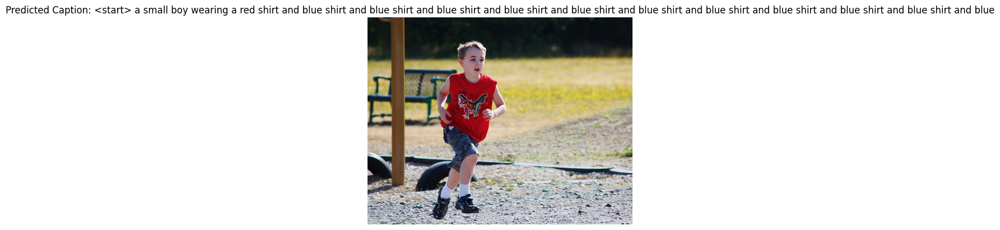

Image ID: 1248734482_3038218f3b
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/1248734482_3038218f3b.jpg
Actual Caption: <start> young girl is laying in the grass posing for the camera <end>
Predicted Caption: <start> a little girl in the grass < end >
METEOR score: 0.3511956930011268
BLEU score as percentage: 0.00%
----------------------


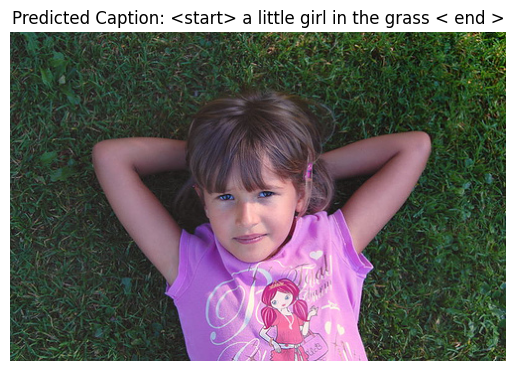

Image ID: 2815755985_0fa55544c0
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2815755985_0fa55544c0.jpg
Actual Caption: <start> young girl laying on blue inflatable toy <end>
Predicted Caption: <start> a blonde girl crawling into a blue inflatable bouncy house < end >
METEOR score: 0.42938931297709926
BLEU score as percentage: 0.00%
----------------------


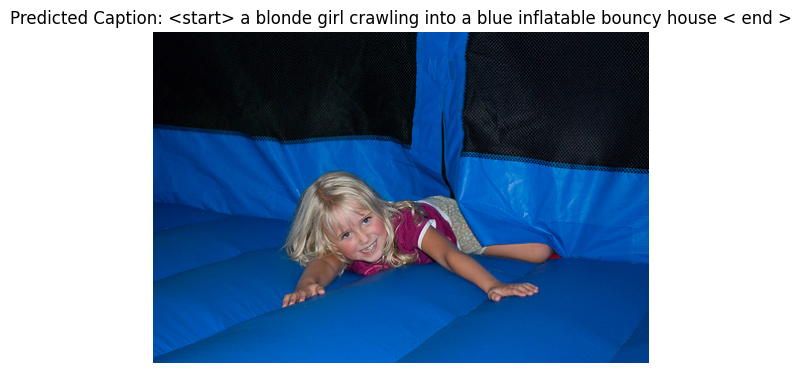

Image ID: 3655773435_c234e94820
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3655773435_c234e94820.jpg
Actual Caption: <start> dog in pool <end>
Predicted Caption: <start> a black dog has just jumped into a swimming pool < end >
METEOR score: 0.5921052631578948
BLEU score as percentage: 18.80%
----------------------


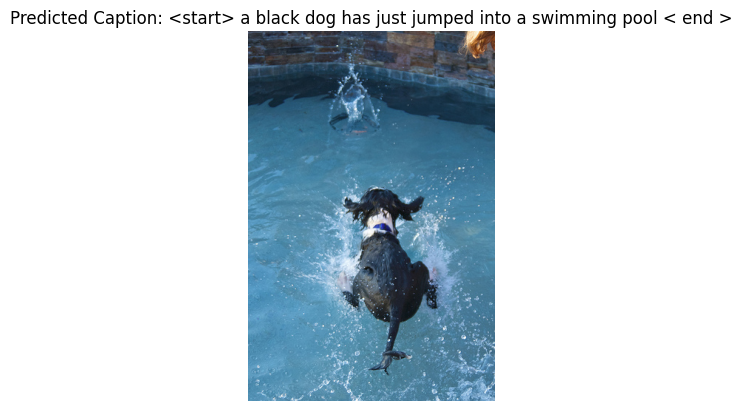

Image ID: 3245070961_8977fdd548
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3245070961_8977fdd548.jpg
Actual Caption: <start> child in black shirt running <end>
Predicted Caption: <start> a boy in a blue shirt runs with her side < end >
METEOR score: 0.4977876106194691
BLEU score as percentage: 0.00%
----------------------


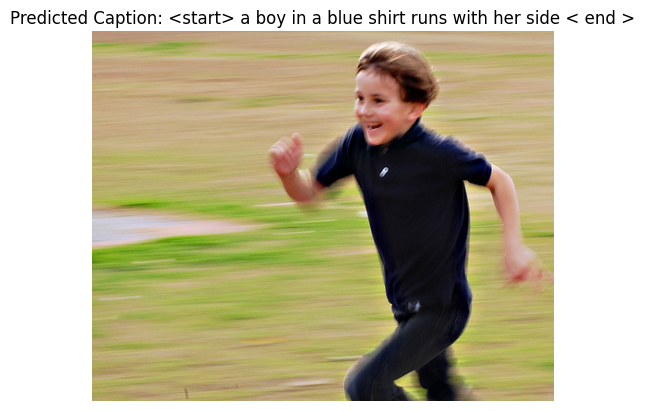

Image ID: 3335692531_dd4a995f91
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3335692531_dd4a995f91.jpg
Actual Caption: <start> three dogs are all tugging on the same toy as they stand behind house <end>
Predicted Caption: <start> two dogs are tugging at the back < end >
METEOR score: 0.33230045945079595
BLEU score as percentage: 0.00%
----------------------


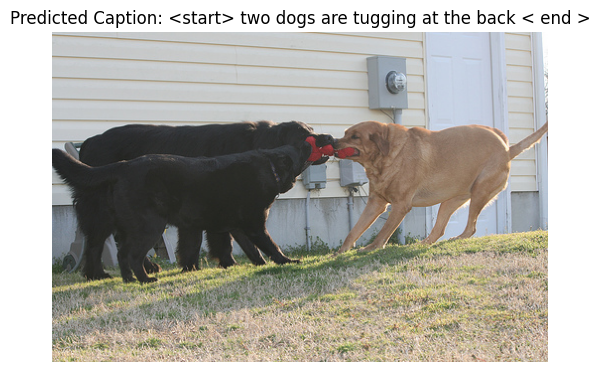

Image ID: 3367851138_757d6bd2ef
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3367851138_757d6bd2ef.jpg
Actual Caption: <start> boat docked at the harbor <end>
Predicted Caption: <start> a man is walking on a dock < end >
METEOR score: 0.34090909090909094
BLEU score as percentage: 0.00%
----------------------


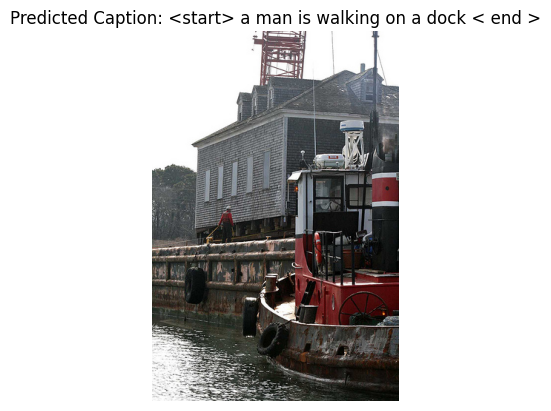

Image ID: 3587092143_c63030ed6d
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3587092143_c63030ed6d.jpg
Actual Caption: <start> two men are kick boxing in kick boxing ring <end>
Predicted Caption: <start> two men are playing soccer < end >
METEOR score: 0.4089506172839506
BLEU score as percentage: 0.00%
----------------------


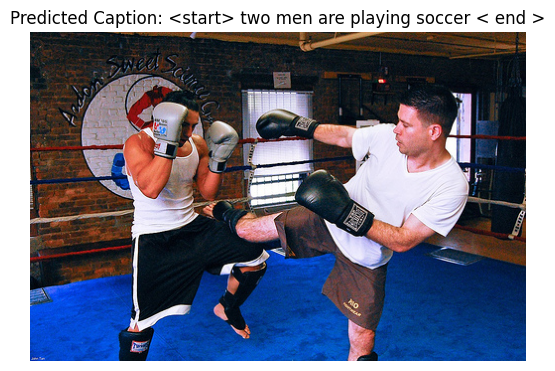

Image ID: 1355945307_f9e01a9a05
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/1355945307_f9e01a9a05.jpg
Actual Caption: <start> the red car has the number seven on the side in white circle <end>
Predicted Caption: <start> a man races around a racetrack < end >
METEOR score: 0.16267648864333945
BLEU score as percentage: 0.00%
----------------------


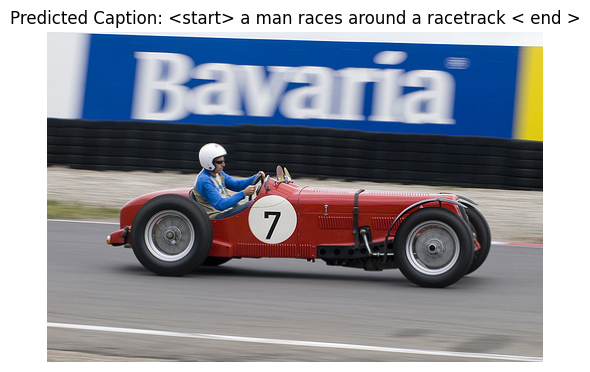

Image ID: 3185645793_49de805194
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3185645793_49de805194.jpg
Actual Caption: <start> mountain biker riding on hillside wearing helmet <end>
Predicted Caption: <start> a woman leaving the camera < end >
METEOR score: 0.2336860670194004
BLEU score as percentage: 0.00%
----------------------


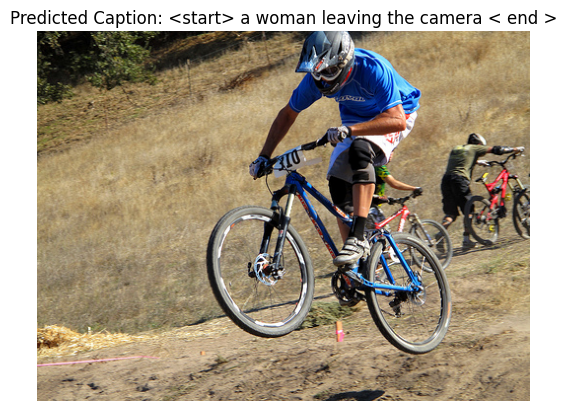

Image ID: 3530843182_35af2c821c
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3530843182_35af2c821c.jpg
Actual Caption: <start> man with sunglasses on his head is looking at the woman with white hat and red scarf next to him whilst standing in front of red sports car <end>
Predicted Caption: <start> a man and sunglasses and a woman < end >
METEOR score: 0.18058327431919136
BLEU score as percentage: 0.00%
----------------------


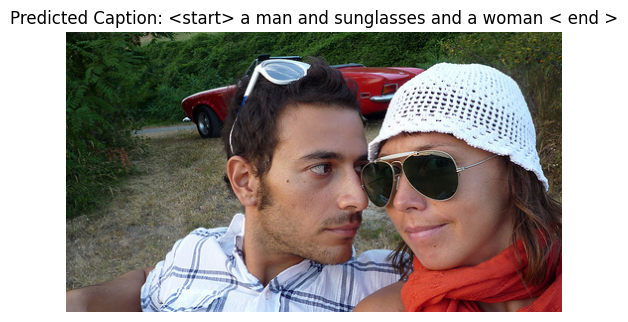

Image ID: 240696675_7d05193aa0
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/240696675_7d05193aa0.jpg
Actual Caption: <start> brown dog is running in grassy plain <end>
Predicted Caption: <start> dog running on narrow dirt path < end >
METEOR score: 0.35118110236220473
BLEU score as percentage: 0.00%
----------------------


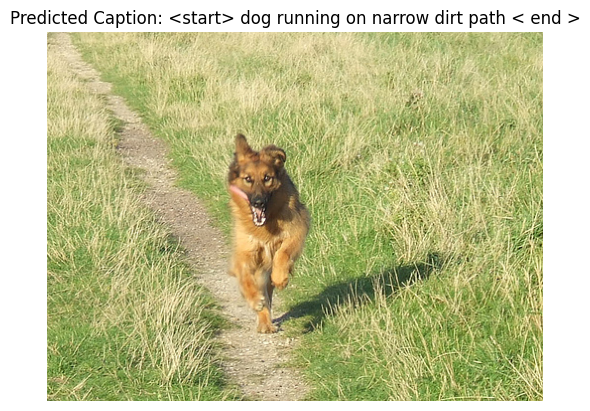

Image ID: 287999021_998c2eeb91
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/287999021_998c2eeb91.jpg
Actual Caption: <start> two mountain climbers sit on mountain <end>
Predicted Caption: <start> two climbers are sitting on top of a mountain attached to ropes < end >
METEOR score: 0.5664062500000001
BLEU score as percentage: 0.00%
----------------------


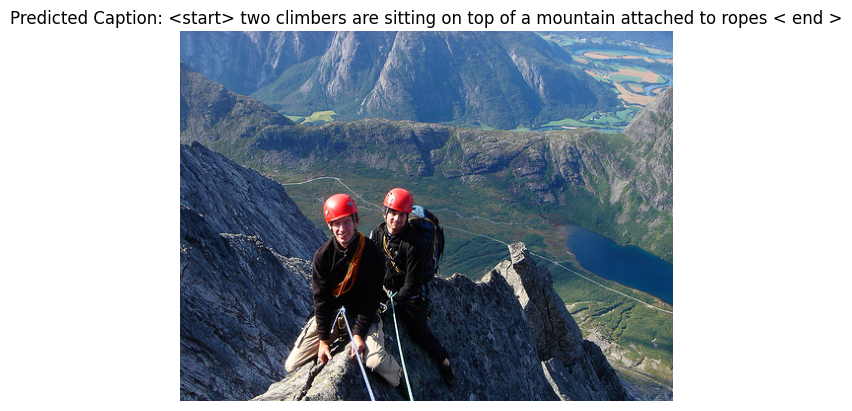

Image ID: 2710698257_2e4ca8dd44
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2710698257_2e4ca8dd44.jpg
Actual Caption: <start> man stands atop rocky cliff over the water <end>
Predicted Caption: <start> an older man in a red shirt is standing on top of a backpack is standing on top of a backpack is standing on top of a backpack is standing on top of a backpack is standing on top
METEOR score: 0.06024096385542168
BLEU score as percentage: 0.00%
----------------------


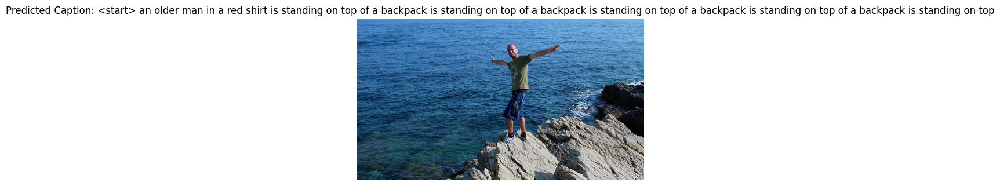

Image ID: 143552697_af27e9acf5
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/143552697_af27e9acf5.jpg
Actual Caption: <start> man on motorcycle riding in dry field wearing helmet and backpack <end>
Predicted Caption: <start> a person with a blue helmet is riding through a clear grassy hill < end >
METEOR score: 0.2623529411764706
BLEU score as percentage: 0.00%
----------------------


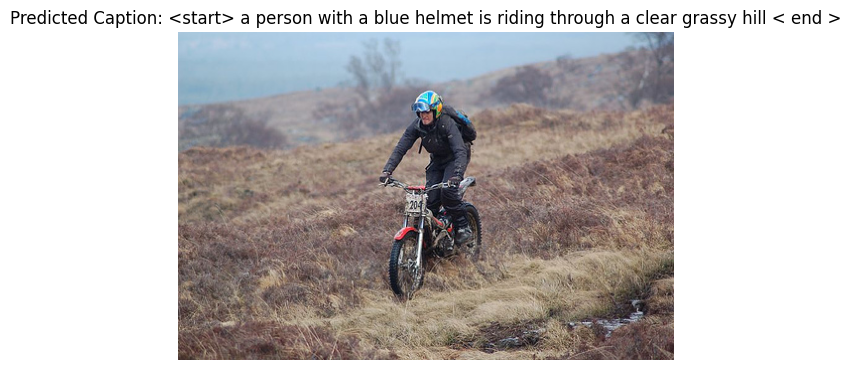

Image ID: 431018958_84b2beebff
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/431018958_84b2beebff.jpg
Actual Caption: <start> girl pushing boat with pole in the water <end>
Predicted Caption: <start> a young girl rows a dock < end >
METEOR score: 0.275735294117647
BLEU score as percentage: 0.00%
----------------------


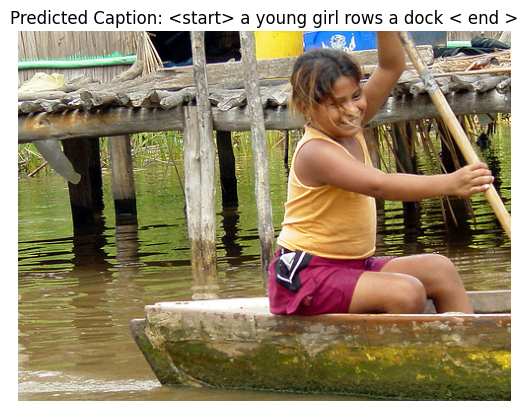

Image ID: 842960985_91daf0d6ec
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/842960985_91daf0d6ec.jpg
Actual Caption: <start> man in tan trench coat and blue jeans walks with black umbrella open over his head <end>
Predicted Caption: <start> a man in blue striped shirt and yellow is walking on a wet street < end >
METEOR score: 0.3251591435185185
BLEU score as percentage: 0.00%
----------------------


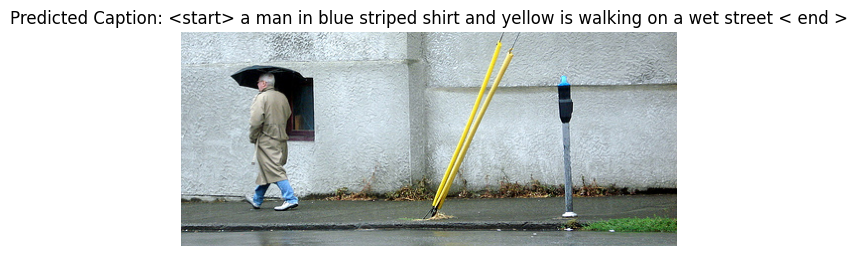

Image ID: 3315110972_1090d11728
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3315110972_1090d11728.jpg
Actual Caption: <start> white heron flies into the sky <end>
Predicted Caption: <start> a large white bird grazes above the water < end >
METEOR score: 0.37166666666666676
BLEU score as percentage: 0.00%
----------------------


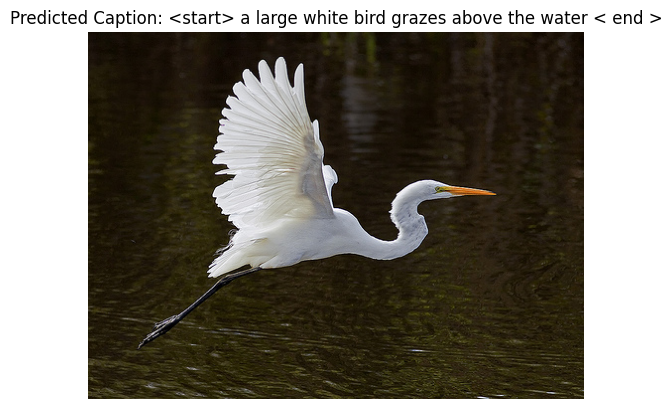

Image ID: 2043427251_83b746da8e
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2043427251_83b746da8e.jpg
Actual Caption: <start> man jumping in mud puddle in the middle of the street <end>
Predicted Caption: <start> a man in blue and black just < unk > down a puddle < end >
METEOR score: 0.3713235294117647
BLEU score as percentage: 0.00%
----------------------


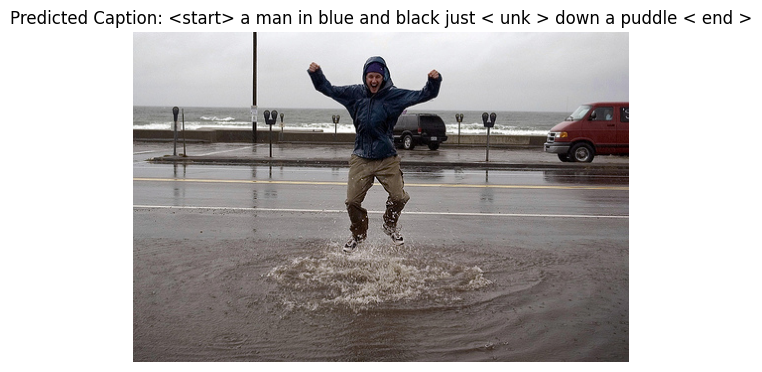

Image ID: 2922981282_203f04bf9b
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2922981282_203f04bf9b.jpg
Actual Caption: <start> young couple lying on bed together <end>
Predicted Caption: <start> a young man and a white shirt and a goofy face < end >
METEOR score: 0.3048780487804878
BLEU score as percentage: 0.00%
----------------------


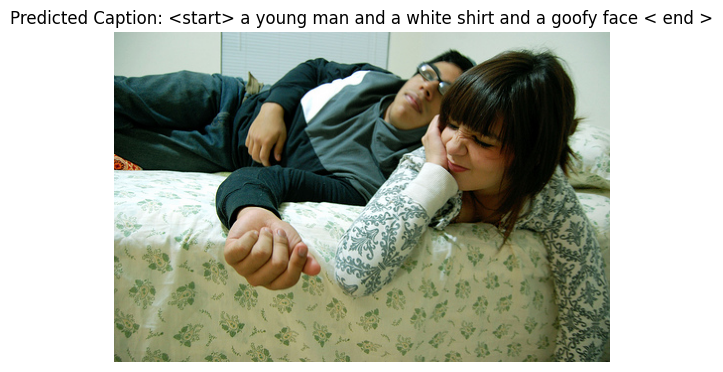

Image ID: 2839932205_3c9c27cd99
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2839932205_3c9c27cd99.jpg
Actual Caption: <start> person is climbing to the top of rock cliff <end>
Predicted Caption: <start> a person climbs a rock face < end >
METEOR score: 0.3524904214559387
BLEU score as percentage: 0.00%
----------------------


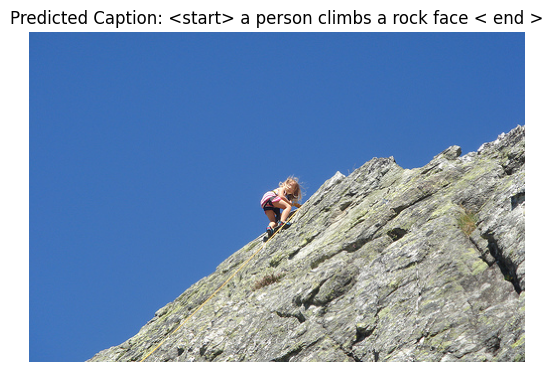

Image ID: 3544233095_4bca71df1d
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3544233095_4bca71df1d.jpg
Actual Caption: <start> child with green bucket on the beach <end>
Predicted Caption: <start> a girl in black is pointing towards a cloudy background < end >
METEOR score: 0.22476675148430877
BLEU score as percentage: 0.00%
----------------------


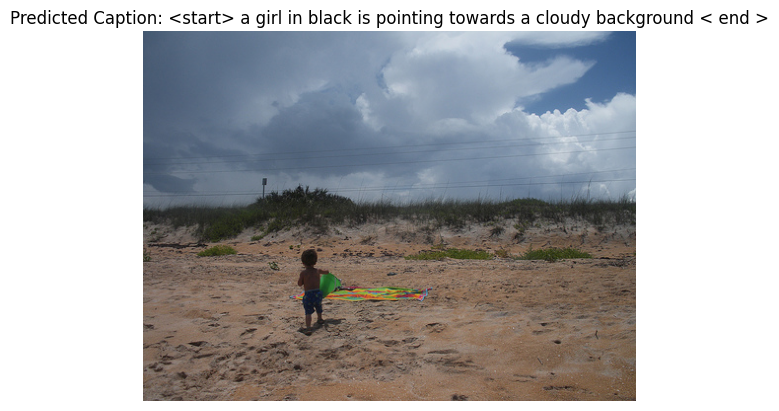

Image ID: 3585495069_33cba06d0a
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3585495069_33cba06d0a.jpg
Actual Caption: <start> group of kids playing dodgeball <end>
Predicted Caption: <start> a group of people are kicking a ball in the gym < end >
METEOR score: 0.42456140350877186
BLEU score as percentage: 0.00%
----------------------


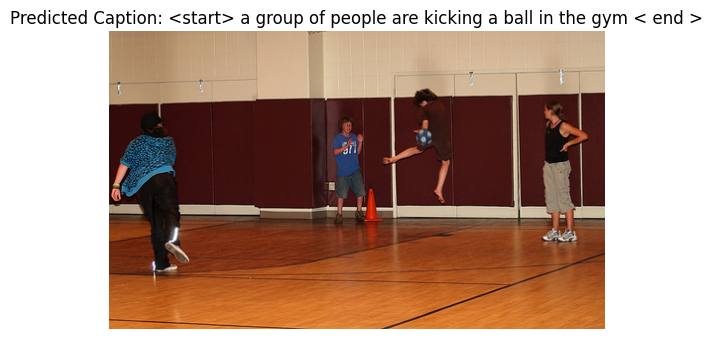

Image ID: 3601508034_5a3bfc905e
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3601508034_5a3bfc905e.jpg
Actual Caption: <start> two men in different colored jerseys play hockey <end>
Predicted Caption: <start> two field hockey players attempt to hit a ball and one in a red and white is swinging a ball and one in a red and white is swinging a ball and one in a red and white is
METEOR score: 0.09036144578313253
BLEU score as percentage: 0.00%
----------------------


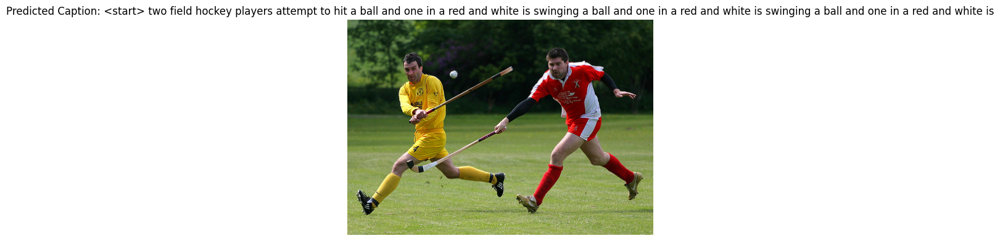

Image ID: 3030824089_e5a840265e
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3030824089_e5a840265e.jpg
Actual Caption: <start> black and tan dog leaps over the green grass <end>
Predicted Caption: <start> a brown and black dog runs through the grass < end >
METEOR score: 0.4745565878378378
BLEU score as percentage: 19.72%
----------------------


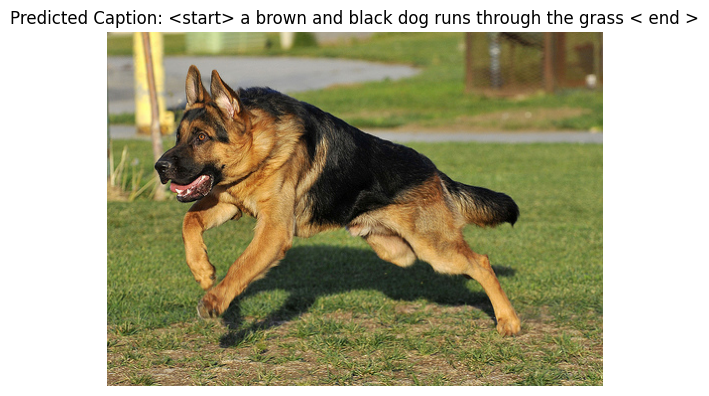

Image ID: 3085667767_66041b202e
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3085667767_66041b202e.jpg
Actual Caption: <start> surfer is flipping up in the air on surfboard <end>
Predicted Caption: <start> a surfer in the water < end >
METEOR score: 0.39062499999999994
BLEU score as percentage: 0.00%
----------------------


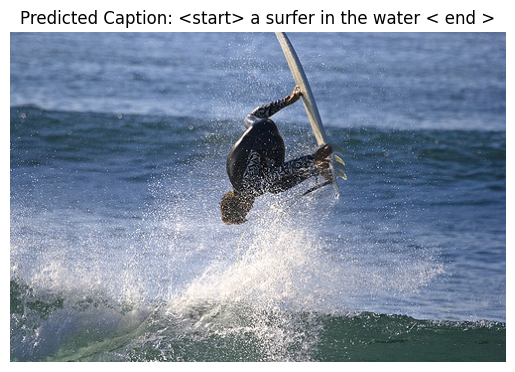

Image ID: 2848571082_26454cb981
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2848571082_26454cb981.jpg
Actual Caption: <start> black dog jumps to catch ball in yard <end>
Predicted Caption: <start> the black dog and brown dog jumps for white dog < end >
METEOR score: 0.3650793650793651
BLEU score as percentage: 0.00%
----------------------


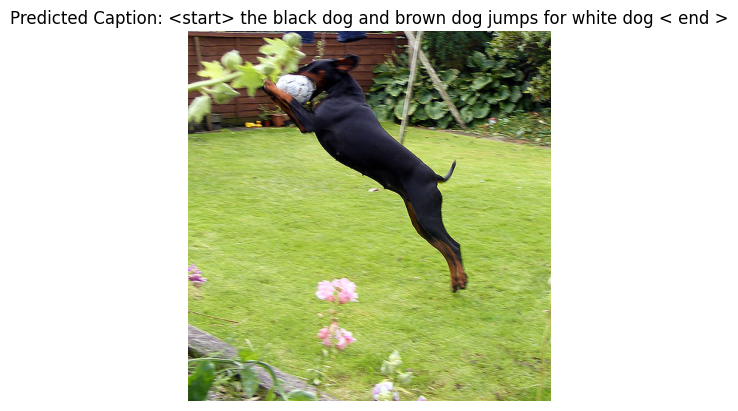

Image ID: 1286408831_05282582ed
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/1286408831_05282582ed.jpg
Actual Caption: <start> boy with his mouth open and tongue sticking out clinging to bar next to platform <end>
Predicted Caption: <start> a boy climbs a fence < end >
METEOR score: 0.18939393939393942
BLEU score as percentage: 0.00%
----------------------


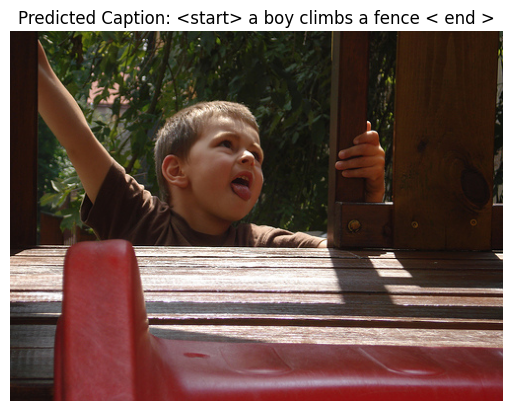

Image ID: 2557972410_6925fe695c
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2557972410_6925fe695c.jpg
Actual Caption: <start> several players playing game of hockey outside on the road <end>
Predicted Caption: <start> the hockey player runs with a game < end >
METEOR score: 0.453125
BLEU score as percentage: 0.00%
----------------------


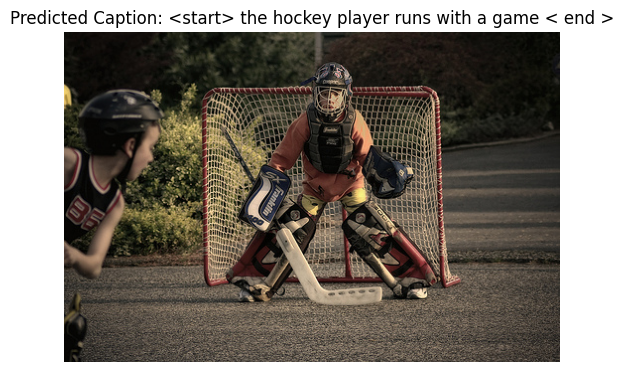

Image ID: 3470303255_fbb41b8dd0
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3470303255_fbb41b8dd0.jpg
Actual Caption: <start> little girl with knit cap smelling flowers <end>
Predicted Caption: <start> a little girl with a white shirt is holding a white shirt is holding a white shirt is holding a white shirt is holding a white shirt is holding a white shirt is holding a white shirt is holding
METEOR score: 0.1875442321302194
BLEU score as percentage: 0.00%
----------------------


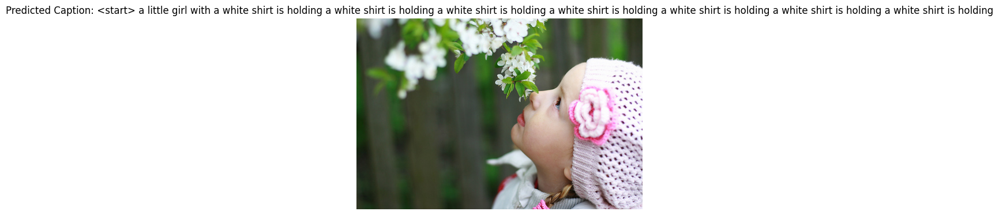

Average METEOR score: 0.32353349852944696
Average BLEU score: 0.04258616666099696


In [49]:
# Initialize lists to store METEOR and BLEU scores
meteor_scores = []
bleu_scores = []
num_images_to_test = 50
test_df = random_testimage_df.head(num_images_to_test)


# Loop through each row of the DataFrame for testing
for index, row in test_df.iterrows():
    image_id = row['Image_ID']
    image_path = row['Image_Path']
    actual_caption = row['Actual_Caption']

    # Display image and details
    print(f"Image ID: {image_id}")
    print(f"Image Path: {image_path}")
    print(f"Actual Caption: {actual_caption}")

    # Evaluate the image to get the predicted caption
    caption = evaluate(image_path)
    if caption is None:
        print("Error: The evaluate function did not return any caption.")
        continue

    # Add <start> and <end> tokens to the predicted caption
    result_final = caption

    # Convert the actual caption and predicted caption to strings
    actual_caption_str = actual_caption
    predicted_caption_str = ' '.join(result_final)
    predicted_caption_token = ['<start>'] + word_tokenize(predicted_caption_str)
    predicted_caption = ' '.join(predicted_caption_token)

    # Calculate METEOR score
    meteor = meteor_score([word_tokenize(actual_caption_str)], predicted_caption_token)
    meteor_scores.append(meteor)

    # Calculate BLEU score for the current image
    bleu_score = sentence_bleu([word_tokenize(actual_caption_str)], predicted_caption_token)
    bleu_scores.append(bleu_score)

    # Display predicted caption and scores
    print(f"Predicted Caption: {(predicted_caption)}")
    print(f"METEOR score: {meteor}")
    bleu_percentage = bleu_score * 100
    print(f"BLEU score as percentage: {bleu_percentage:.2f}%")
    print("----------------------")

    # Display the image
    img = Image.open(image_path)
    plt.imshow(img)
    plt.title("Predicted Caption: " + predicted_caption)
    plt.axis('off')
    plt.show()

# Check if there are any predicted captions and meteor scores
if len(meteor_scores) == 0:
    print("No predicted captions generated.")
else:
    # Calculate the average METEOR score
    average_meteor_score = sum(meteor_scores) / len(meteor_scores)
    print("Average METEOR score:", average_meteor_score)

    # Calculate the average BLEU score for all images
    average_bleu_score = sum(bleu_scores) / len(bleu_scores)
    print("Average BLEU score:", average_bleu_score)
